## Imports

In [1]:
import sys
import os
current_dir = os.getcwd()
project_root = os.path.abspath(os.path.join(current_dir, '..'))
sys.path.append(project_root)

import pandas as pd 
import matplotlib.pyplot as plt
import utils.NN_preprocessing as NN_preprocessing
import utils.visualization as visualization
import utils.generic as generic
import utils.df_operations as df_operations
import folium
import numpy as np  
import plotly.graph_objects as go


#reload 
import importlib
importlib.reload(visualization)

pygame 2.6.1 (SDL 2.28.4, Python 3.11.10)
Hello from the pygame community. https://www.pygame.org/contribute.html


<module 'utils.visualization' from 'c:\\Users\\UFMG\\Periodos\\Periodo_XIV\\TCC\\Projeto\\Códigos\\tcc_ovitraps\\utils\\visualization.py'>

In [2]:
# Load the data.
data = pd.read_csv('../data/final_data.csv',parse_dates=['dtcol'])
data['log_novos'] = np.log(data['novos'])

c:\Users\User\miniconda3\envs\venv_ovitraps\Lib\site-packages\pandas\core\arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [85]:
data_no0 = data[data['novos'] > 0]
data_2_1000  = data[(data['novos'] > 2) & (data['novos'] <= 1000)]
data_1_100  = data[(data['novos'] > 0) & (data['novos'] <= 100)]
data_101_1000  = data[(data['novos'] > 100) & (data['novos'] <= 1000)]
data_1001_inf  = data[(data['novos'] > 1000)]


In [86]:
data_log_noinf = data[data['log_novos'] > -1]
data_log_2_inf  = data[(data['log_novos'] > np.log(1))]
data_log_3_inf = data[(data['log_novos'] > np.log(2))]


### Divide data

In [5]:
trap_by_year = data['anoepid'].value_counts().reset_index().sort_values('anoepid')
trap_by_cat = data['GerCat'].value_counts().reset_index().sort_values('GerCat')
trap_by_reg = data['distrito'].value_counts().reset_index().sort_values('distrito')


## Histograms

### All data

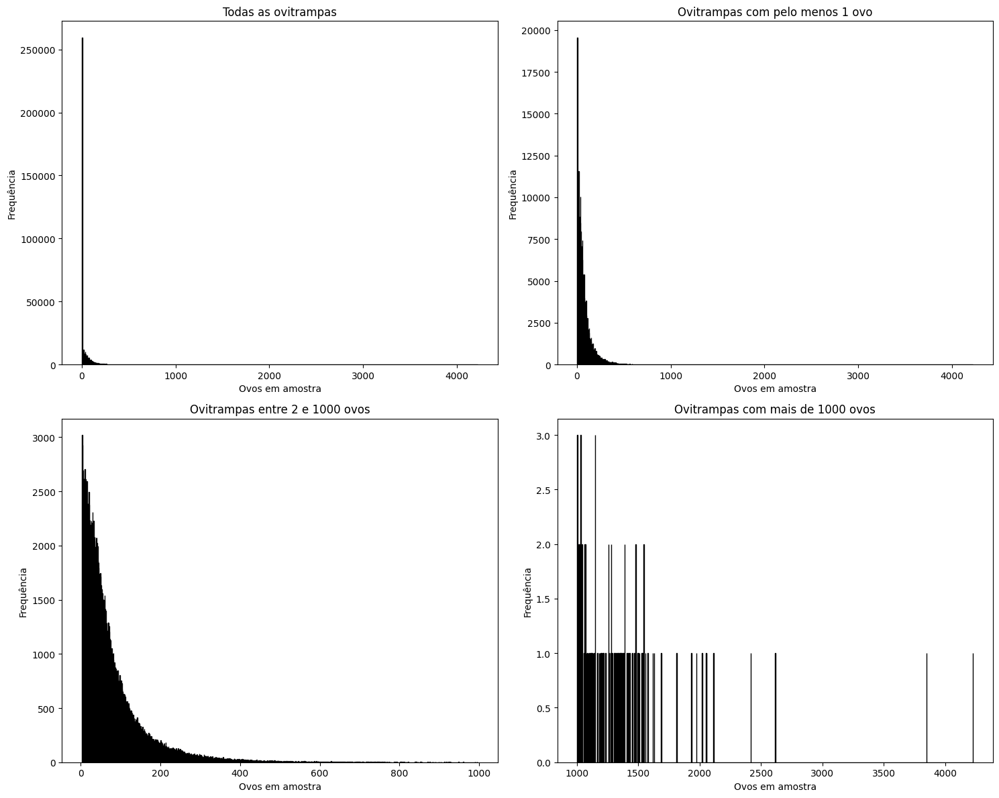

In [98]:
fig,axs = plt.subplots(nrows = 2, ncols = 2,figsize=(15, 12))    

axs[0,0].hist(data['novos'], bins=1000, color='blue', edgecolor='black')
axs[0,0].set_title('Todas as ovitrampas')
axs[0, 0].set_xlabel('Ovos em amostra')
axs[0, 0].set_ylabel('Frequência')

axs[0,1].hist(data_no0['novos'], bins=1000, color='blue', edgecolor='black')
axs[0,1].set_title('Ovitrampas com pelo menos 1 ovo')
axs[0, 1].set_xlabel('Ovos em amostra')
axs[0, 1].set_ylabel('Frequência')

axs[1,0].hist(data_2_1000['novos'], bins=1000, color='blue', edgecolor='black')
axs[1,0].set_title('Ovitrampas entre 2 e 1000 ovos')
axs[1, 0].set_xlabel('Ovos em amostra')
axs[1, 0].set_ylabel('Frequência')


axs[1,1].hist(data_1001_inf['novos'], bins=1000, color='blue', edgecolor='black')
axs[1,1].set_title('Ovitrampas com mais de 1000 ovos')
axs[1,1].set_xlabel('Ovos em amostra')
axs[1,1].set_ylabel('Frequência')


plt.tight_layout()
plt.show()

### Log

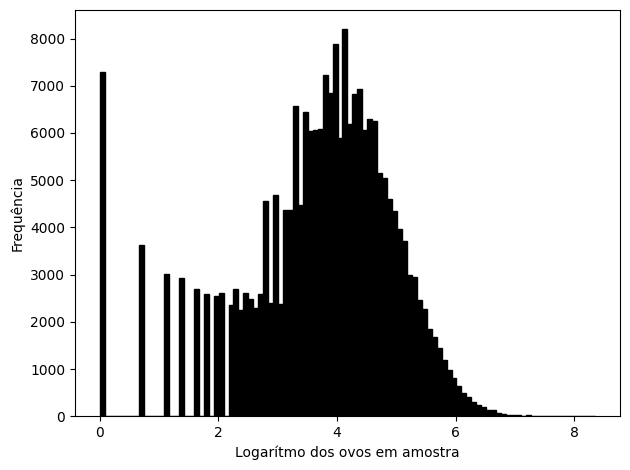

In [100]:

plt.hist(data_log_noinf['log_novos'], bins=100, color='black', edgecolor='black')
plt.xlabel('Logarítmo dos ovos em amostra')
plt.ylabel('Frequência')
plt.tight_layout()
plt.show()

### Annual

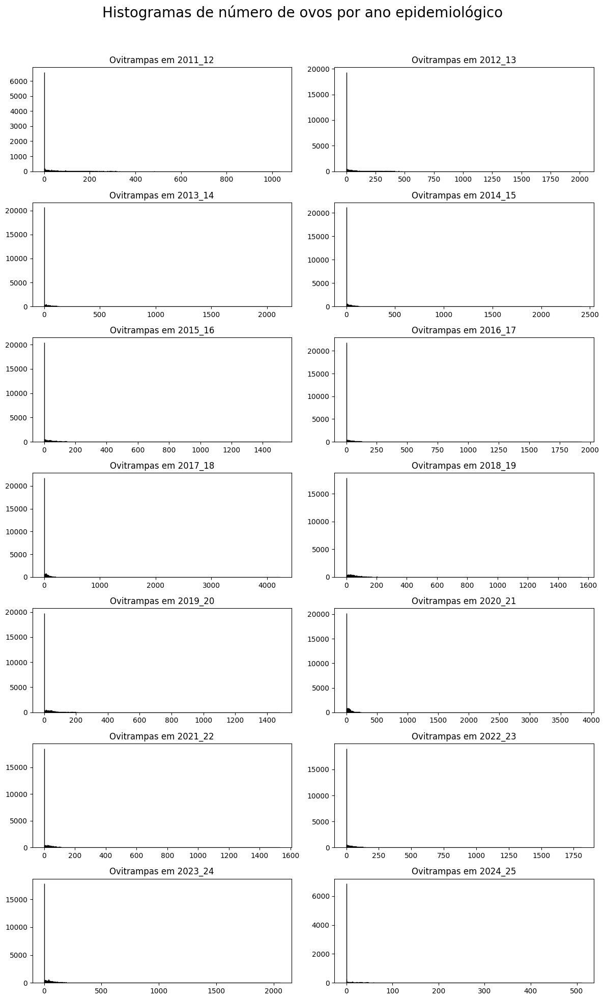

In [8]:
fig,axs = plt.subplots(nrows = 7, ncols = 2,figsize=(12, 20))    
plt.suptitle('Histogramas de número de ovos por ano epidemiológico', fontsize=20)

j = 1 #plot index
count = 0
for i in trap_by_year['anoepid']:
    j = abs(j-1) # 0 or 1
    
    
    data_year = data[data['anoepid'] == i]
    axs[count,j].hist(data_year['novos'], bins=1000, color='blue', edgecolor='black')
    axs[count,j].set_title('Ovitrampas em ' + i)
    count += j

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

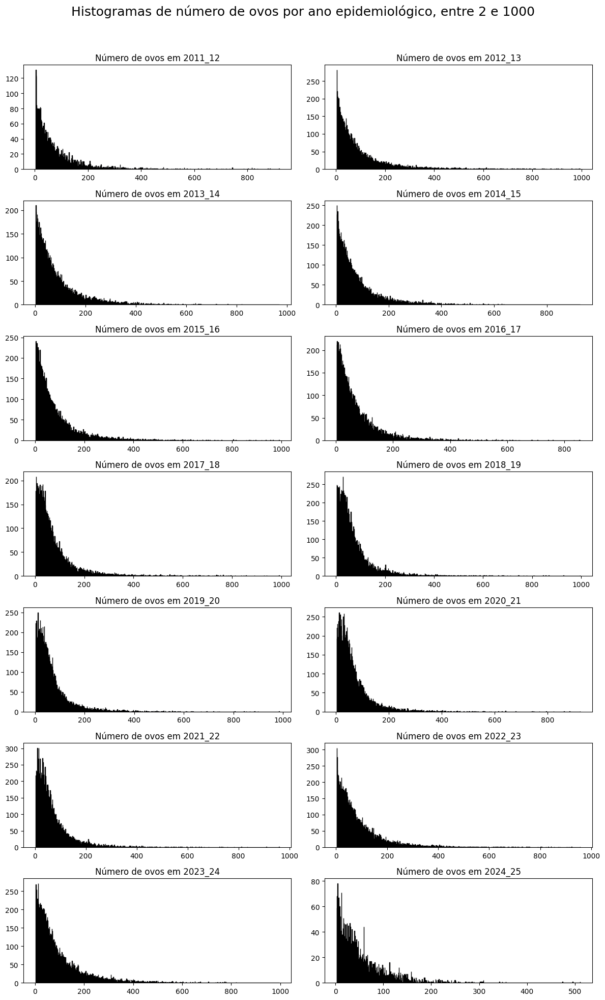

In [9]:
fig,axs = plt.subplots(nrows = 7, ncols = 2,figsize=(12, 20))    
plt.suptitle('Histogramas de número de ovos por ano epidemiológico, entre 2 e 1000', fontsize=18)

j = 1 #plot index
count = 0
for i in trap_by_year['anoepid']:
    j = abs(j-1) # 0 or 1
    
    
    data_year = data_2_1000[data_2_1000['anoepid'] == i]
    axs[count,j].hist(data_year['novos'], bins=1000, color='blue', edgecolor='black')
    axs[count,j].set_title('Número de ovos em ' + i)
    count += j

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Category

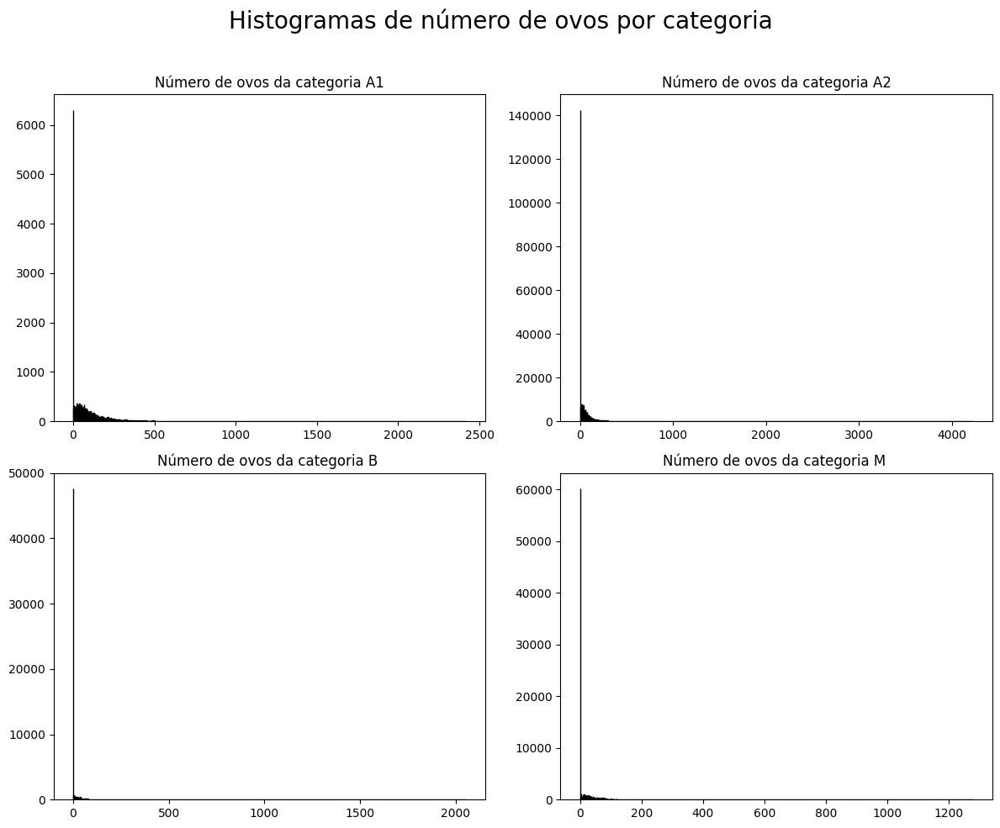

In [10]:
fig,axs = plt.subplots(nrows = 2, ncols = 2,figsize=(12, 10))    
plt.suptitle('Histogramas de número de ovos por categoria', fontsize=20)

j = 1 #plot index
count = 0
for i in trap_by_cat['GerCat']:
    j = abs(j-1) # 0 or 1
    
    
    data_cat = data[data['GerCat'] == i]
    axs[count,j].hist(data_cat['novos'], bins=1000, color='blue', edgecolor='black')
    axs[count,j].set_title('Número de ovos da categoria ' + i)
    count += j

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

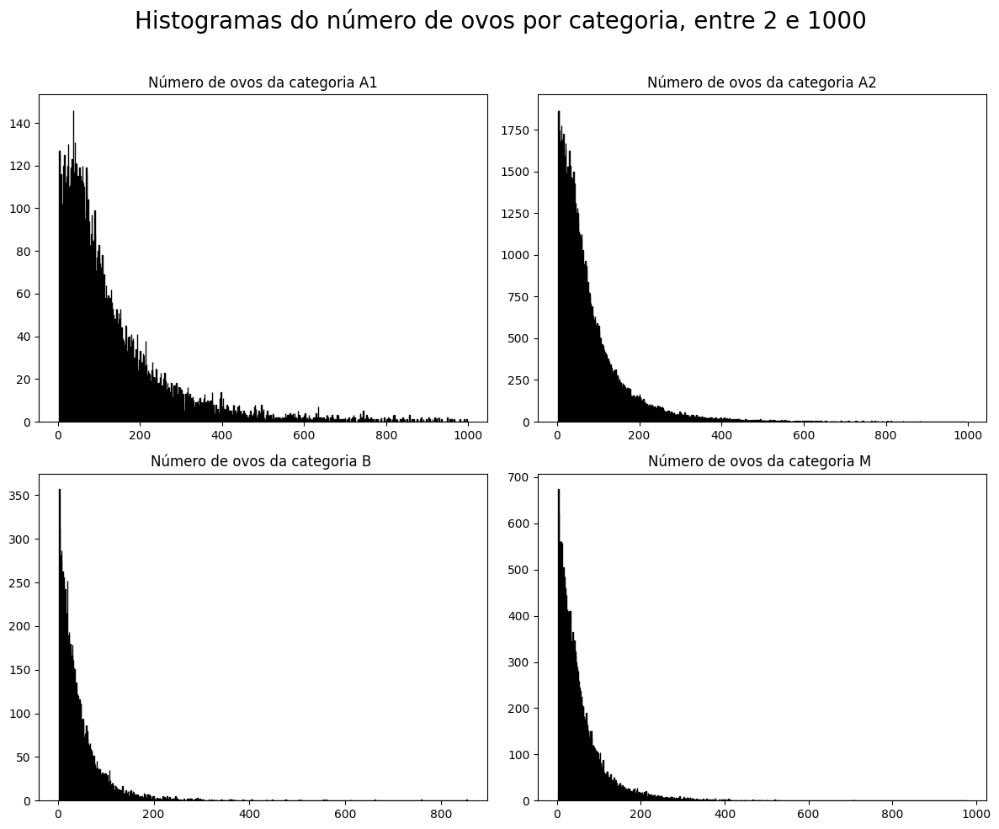

In [11]:
fig,axs = plt.subplots(nrows = 2, ncols = 2,figsize=(12, 10))    
plt.suptitle('Histogramas do número de ovos por categoria, entre 2 e 1000', fontsize=20)

j = 1 #plot index
count = 0
for i in trap_by_cat['GerCat']:
    j = abs(j-1) # 0 or 1
    
    
    data_cat = data_2_1000[data_2_1000['GerCat'] == i]
    axs[count,j].hist(data_cat['novos'], bins=1000, color='blue', edgecolor='black')
    axs[count,j].set_title('Número de ovos da categoria ' + i)
    count += j

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Region

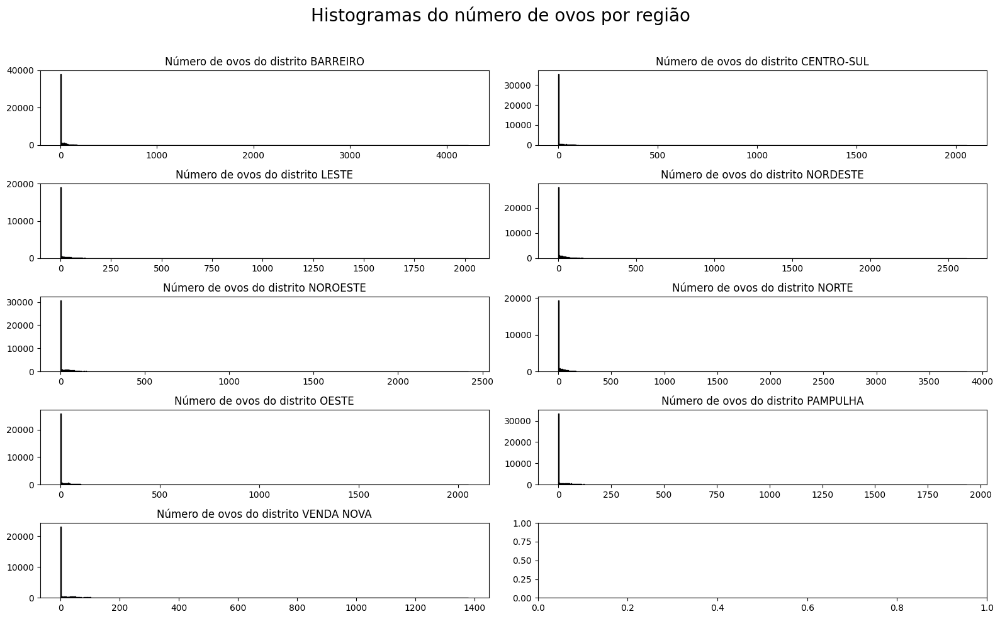

In [12]:
fig,axs = plt.subplots(nrows = 5, ncols = 2,figsize=(16, 10))    
plt.suptitle('Histogramas do número de ovos por região', fontsize=20)

j = 1 #plot index
count = 0
for i in trap_by_reg['distrito']:
    j = abs(j-1) # 0 or 1
    
    
    data_cat = data[data['distrito'] == i]
    axs[count,j].hist(data_cat['novos'], bins=1000, color='blue', edgecolor='black')
    axs[count,j].set_title('Número de ovos do distrito ' + i)
    count += j

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

C:\Users\User\AppData\Local\Temp\ipykernel_10624\2505396404.py:10: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  data_cat = data_2_1000[data['distrito'] == i]
C:\Users\User\AppData\Local\Temp\ipykernel_10624\2505396404.py:10: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  data_cat = data_2_1000[data['distrito'] == i]
C:\Users\User\AppData\Local\Temp\ipykernel_10624\2505396404.py:10: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  data_cat = data_2_1000[data['distrito'] == i]
C:\Users\User\AppData\Local\Temp\ipykernel_10624\2505396404.py:10: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  data_cat = data_2_1000[data['distrito'] == i]
C:\Users\User\AppData\Local\Temp\ipykernel_10624\2505396404.py:10: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  data_cat = data_2_1000[data['distrito'] == i]
C:\Users\User\AppData\Local\Temp\ipykernel_10

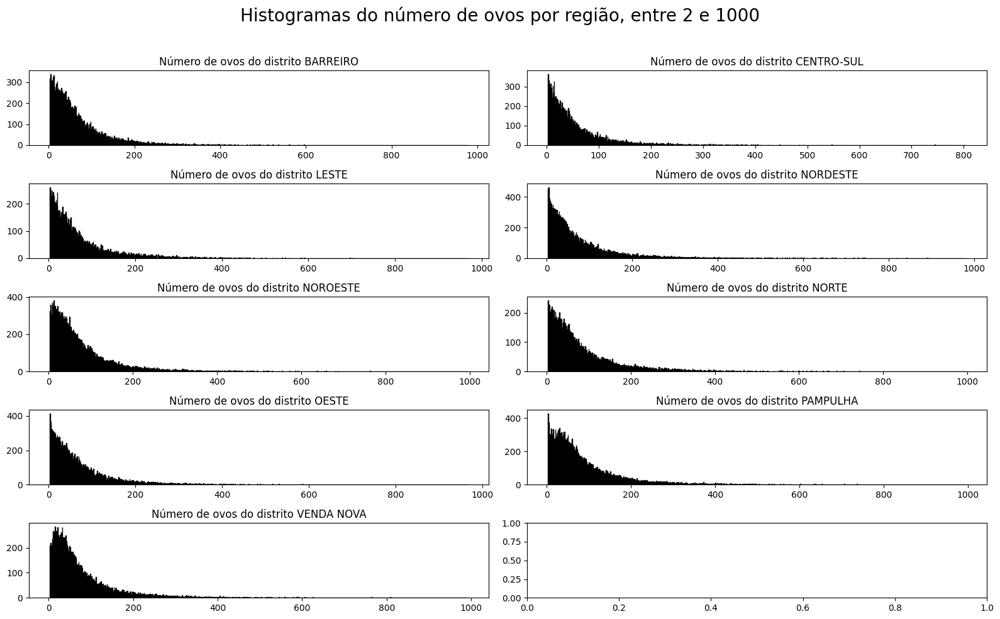

In [13]:
fig,axs = plt.subplots(nrows = 5, ncols = 2,figsize=(16, 10))    
plt.suptitle('Histogramas do número de ovos por região, entre 2 e 1000', fontsize=20)

j = 1 #plot index
count = 0
for i in trap_by_reg['distrito']:
    j = abs(j-1) # 0 or 1
    
    
    data_cat = data_2_1000[data['distrito'] == i]
    axs[count,j].hist(data_cat['novos'], bins=1000, color='blue', edgecolor='black')
    axs[count,j].set_title('Número de ovos do distrito ' + i)
    count += j

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

## Time Series 

### Weekly traps sum

In [14]:
traps_week_sum = data[['nplaca','anoepid','semepi']].groupby(['anoepid','semepi']).count().reset_index()

visualization.plot_time_series_yearly(traps_week_sum, 'nplaca', 'week','Soma de armadilhas por semana epidemiológica', 'Semana epidemiológica', 'Soma de armadilhas',True)
visualization.plot_time_series_yearly(traps_week_sum, 'nplaca', 'week','Soma de armadilhas por semana epidemiológica', 'Semana epidemiológica', 'Soma de armadilhas')


### Monthly traps sum

In [15]:
traps_month_sum = data[['nplaca','anoepid','mesepid']].groupby(['anoepid','mesepid']).count().reset_index()

visualization.plot_time_series_yearly(traps_month_sum, 'nplaca', 'month','Soma de armadilhas por mês', 'Mês', 'Soma de armadilhas',True)
visualization.plot_time_series_yearly(traps_month_sum, 'nplaca', 'month','Soma de armadilhas por mês', 'Mês', 'Soma de armadilhas')


### Weekly eggs sum 

In [16]:
ovos_week_sum = data[['novos','anoepid','semepi']].groupby(['anoepid','semepi']).sum().reset_index()
visualization.plot_time_series_yearly(ovos_week_sum, 'novos', 'week','Soma de ovos por semana epidemiológica', 'Semana epidemiológica', 'Soma de ovos')

### Weekly eggs mean

In [115]:
ovos_week_mean = data[['novos','anoepid','semepi']].groupby(['anoepid','semepi']).mean().reset_index()
fig = visualization.plot_time_series_yearly(ovos_week_mean, 'novos','week' ,'Média de ovos por semana', 'Semana', 'Média de ovos')


### Add sine of week
#offset = 30
#x = list(range(1,53))
#y = [np.sqrt(np.sin(np.pi*(i-offset)/53)**2) * 100 for i in x]


fig.add_trace(go.Scatter(
   # x= list(x),
   # y = y,
    mode='lines',
    line=dict(color='#000000', width=3, dash='dash')  ,
    name= 'Seno do mês',  # Convert year to string for the legend
    legendrank=1
))


In [128]:
for trace in fig.data:
    # Apply shift and wrap for each trace (for each year)
    trace_x = trace.x  # Get the current x values
    if trace_x is None:
        continue
    shifted_x = [(x + 30) % 53 for x in trace_x]  # Shift and wrap
    trace.x = shifted_x  # Update the trace with the new x values

# Return the modified fig object
fig


### Monthly eggs sum

In [131]:
ovos_month_sum = data[['novos','anoepid','mesepid']].groupby(['anoepid','mesepid']).sum().reset_index()
visualization.plot_time_series_yearly(ovos_month_sum, 'novos','month' ,'', 'Mês epidemiológico', 'Número de ovos')


### Month eggs mean

In [174]:
importlib.reload(visualization)
ovos_month_mean = data[['novos','anoepid','mesepid']].groupby(['anoepid','mesepid']).mean().reset_index()
fig = visualization.plot_time_series_yearly(ovos_month_mean, 'novos','month' ,'', 'Mês epidemiológico', 'Média de ovos')
### Add sine of month
x = list(range(1,13))
y = [np.sqrt(np.sin(np.pi*(i-2)/12)**2) * 100 for i in x]


fig.add_trace(go.Scatter(
    x= list(x),
    y = y,
    mode='lines',
    line=dict(color='#000000', width=3, dash='dash')  ,
    name= 'Seno do mês',  # Convert year to string for the legend
    legendrank=1
))

fig
#



### Weekly eggs sum by category

In [143]:
ovos_week_cat_sum = data[['novos','anoepid','semepi','GerCat']].groupby(['anoepid','semepi','GerCat']).sum().reset_index()
visualization.plot_time_series_cat(ovos_week_cat_sum, 'novos', 'week','Soma de ovos por semana epidemiológica por categoria', 'Semana epidemiológica', 'Soma de ovos')

### Weekly eggs mean by category

In [21]:
ovos_week_cat_mean = data[['novos','anoepid','semepi','GerCat']].groupby(['anoepid','semepi','GerCat']).mean().reset_index()
visualization.plot_time_series_cat(ovos_week_cat_mean, 'novos', 'week','Média de ovos por semana epidemiológica por categoria', 'Semana epidemiológica', 'Média de ovos')

### Monthly eggs sum by category

In [22]:
ovos_month_cat_sum = data[['novos','anoepid','mesepid','GerCat']].groupby(['anoepid','mesepid','GerCat']).sum().reset_index()
visualization.plot_time_series_cat(ovos_month_cat_sum, 'novos', 'month','Soma de ovos por mês por categoria', 'Mês', 'Soma de ovos')

### Monthly eggs mean by category

In [171]:
importlib.reload(visualization)
ovos_month_cat_mean = data[['novos','anoepid','mesepid','GerCat']].groupby(['anoepid','mesepid','GerCat']).mean().reset_index()
visualization.plot_time_series_cat(ovos_month_cat_mean, 'novos', 'month','Média de ovos por mês por categoria', 'Mês Epidemiológico', 'Média de ovos')


## Pareto Plots

### Artificial Data

In [101]:
importlib.reload(visualization)

<module 'utils.visualization' from 'c:\\Users\\UFMG\\Periodos\\Periodo_XIV\\TCC\\Projeto\\Códigos\\tcc_ovitraps\\utils\\visualization.py'>

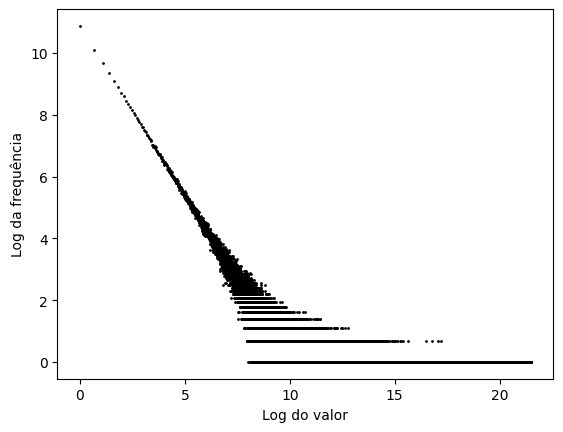

In [102]:
from scipy.stats import zipf
# Parameters for the Pareto distribution
alpha = 1.1 # Shape parameter
x_m = 1     # Minimum value
n = 500000    # Number of data points

# Generate Pareto-distributed data
pareto_data = zipf.rvs(alpha, size=n)
pareto_data = pd.Series(pareto_data,name="pareto")
visualization.pareto_plot(pareto_data,"")


### All data

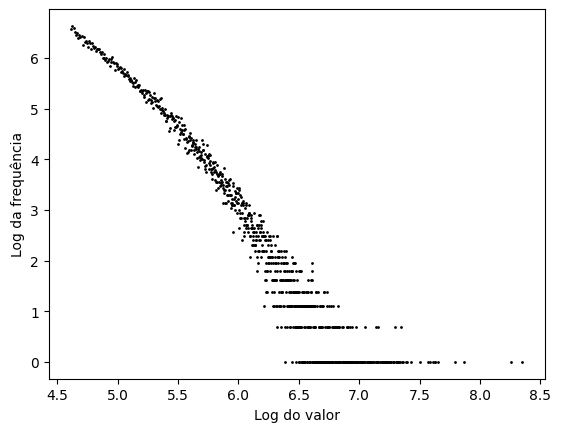

In [107]:
data_10_inf  = data[(data['novos'] > 100)]
visualization.pareto_plot(data_10_inf['novos'],"")    

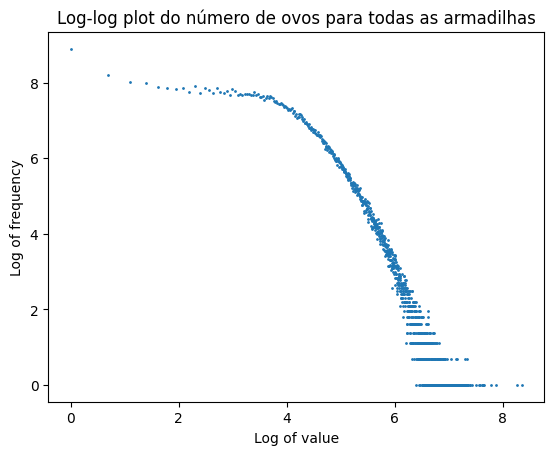

In [26]:
visualization.pareto_plot(data['novos'],plt_title= "Log-log plot do número de ovos para todas as armadilhas")


Plot linear regression of logs but only with data larger than 100

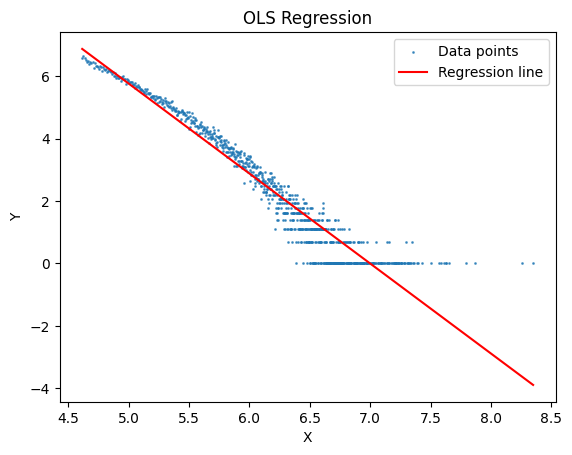

In [27]:
import statsmodels.api as sm

df = data['novos'].value_counts().sort_index().reset_index()     #count values
df.drop(df[df['novos'] == 0].index, inplace=True)          #drop index 0
df = df.apply(lambda x: np.log(x))                      # apply log to valuesa
df_filter = df[df['novos'] > np.log(100)]



model_log = sm.OLS(df_filter['count'], sm.add_constant(df_filter['novos'])).fit()
y_pred = model_log.predict(sm.add_constant(df_filter['novos']))

# Plot data and regression line
plt.scatter(df_filter['novos'], df_filter['count'], label="Data points", alpha=0.7,s=1)
plt.plot(df_filter['novos'], y_pred, color="red", label="Regression line")
plt.xlabel("X")
plt.ylabel("Y")
plt.legend()
plt.title("OLS Regression")
plt.show()



### Annual


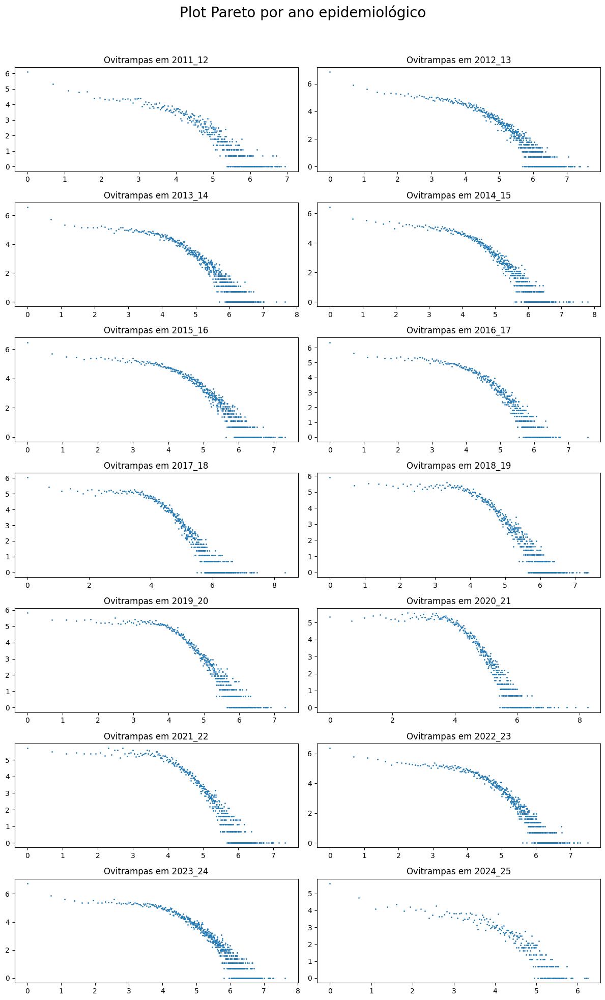

In [28]:
fig, axs = plt.subplots(nrows = 7, ncols = 2,figsize=(12, 20))    
plt.suptitle('Plot Pareto por ano epidemiológico', fontsize=20)

j = 1 #plot index
count = 0
for i in trap_by_year['anoepid']:
    j = abs(j-1) # 0 or 1
    data_year = data[data['anoepid'] == i]
    visualization.pareto_plot(data_year['novos'], plt_title = 'Ovitrampas em ' + i, ax = axs[count,j])
    count += j

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Category

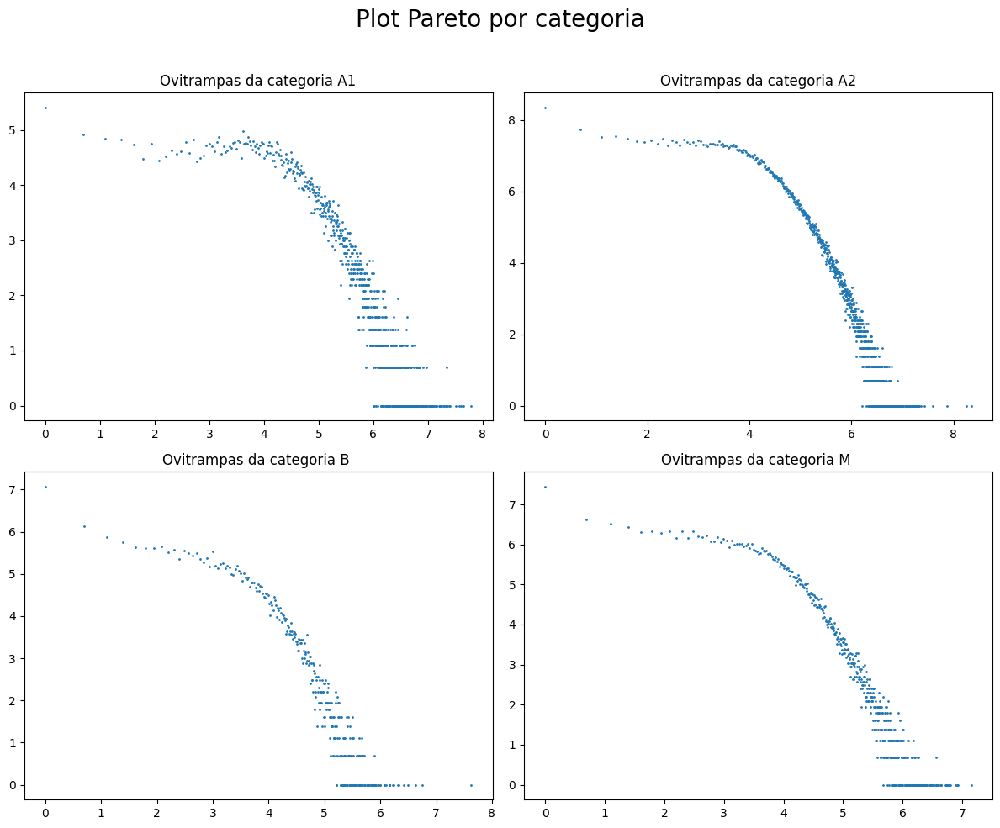

In [29]:
fig,axs = plt.subplots(nrows = 2, ncols = 2,figsize=(12, 10))    
plt.suptitle('Plot Pareto por categoria', fontsize=20)

j = 1 #plot index
count = 0
for i in trap_by_cat['GerCat']:
    j = abs(j-1) # 0 or 1
    data_cat = data[data['GerCat'] == i]
    visualization.pareto_plot(data_cat['novos'], plt_title = 'Ovitrampas da categoria ' + i, ax = axs[count,j])
    axs[count,j].set_title('Ovitrampas da categoria ' + i)
    count += j

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

### Region

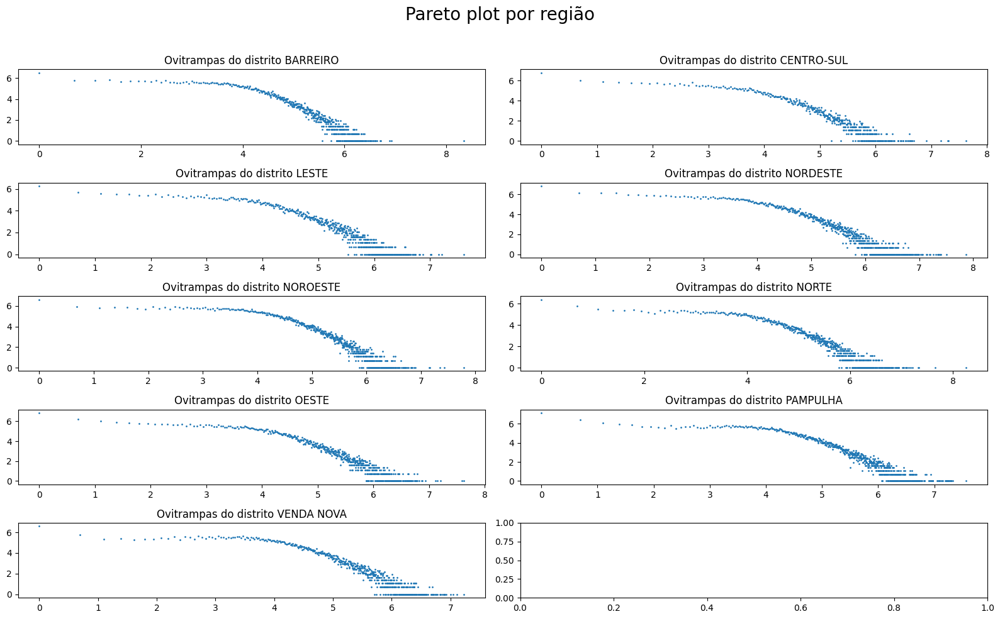

In [30]:
fig,axs = plt.subplots(nrows = 5, ncols = 2,figsize=(16, 10))    
plt.suptitle('Pareto plot por região', fontsize=20)

j = 1 #plot index
count = 0
for i in trap_by_reg['distrito']:
    j = abs(j-1) # 0 or 1    
    data_cat = data[data['distrito'] == i]
    visualization.pareto_plot(data_cat['novos'], plt_title = 'Ovitrampas do distrito ' + i, ax = axs[count,j])
    axs[count,j].set_title('Ovitrampas do distrito ' + i)
    count += j

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

## Maps

In [3]:
map_df = data[['narmad','coordx','coordy','GerCat','coordx2','coordy2','latitude','longitude']]
map_df = map_df.drop_duplicates().reset_index(drop=True)
map_df = map_df.merge(data['narmad'].value_counts().reset_index(),on='narmad',how='left') # count number of traps
map_df = map_df.merge(data.groupby('narmad')['novos'].sum().reset_index() ,on='narmad',how='left') # count number of eggs
map_df = map_df.merge(data.groupby('narmad')['novos'].mean().reset_index().rename(columns={'novos':'mean'}) ,on='narmad',how='left') # count number of eggs

# TODO: treat this better
map_df.where(map_df['longitude'] != 0, inplace=True)
map_df.where(map_df['latitude'] != -19.047717, inplace=True)

map_df_noNaN = map_df.dropna(subset=['latitude','longitude']).reset_index(drop=True)



### Location 

In [22]:
# Create a map centered at the average latitude and longitude
map_center = [map_df_noNaN['latitude'].mean(), map_df_noNaN['longitude'].mean()]
mymap = folium.Map(location=map_center, zoom_start=11)

# Add points to the map
for index, row in map_df_noNaN.iterrows():
    
    # Add a custom marker for a very small dot
    folium.Marker(
        location=(row['latitude'], row['longitude']),
        icon=folium.DivIcon(
            html='<div style="width: 3px; height: 3px; background-color: black; border-radius: 50%;"></div>'
        )
    ).add_to(mymap)


#title_html = '''<h3 align="center" style="font-size:20px"><b>Mapa por posição</b></h3>'''
#mymap.get_root().html.add_child(folium.Element(title_html))
# Save map as HTML
mymap.save("../results/maps/map_location.html")

### Number of traps

In [28]:
# Create a map centered at the average latitude and longitude
map_center = [map_df_noNaN['latitude'].mean(), map_df_noNaN['longitude'].mean()]
mymap = folium.Map(location=map_center, zoom_start=11)

# Add points to the map
for index, row in map_df_noNaN.iterrows():
    folium.CircleMarker(
        location=(row['latitude'], row['longitude']),
        radius=row['count']/120,  # Size of the circle
        color= 'black',  # Circle color
        fill=True,
        fill_color='black',  # Fill color
        fill_opacity=0.8,  # Fill opacity
        tooltip=f"Category: {row['GerCat']}, Value: {row['count']}"
    ).add_to(mymap)

#title_html = '''<h3 align="center" style="font-size:20px"><b>Mapa por contagem de amostras</b></h3>'''
#mymap.get_root().html.add_child(folium.Element(title_html))

# Save map as HTML
mymap.save("../results/maps/map_sum_traps.html")

In [30]:
map_df_noNaN['count'].describe()

count    1771.000000
mean      264.363072
std        82.271761
min         8.000000
25%       282.000000
50%       294.000000
75%       299.000000
max       311.000000
Name: count, dtype: float64

### Categories

In [36]:
perc_dict = {}
data__ = data[['narmad','novos']]
for index, row in map_df_noNaN.iterrows():
    data_row = df_operations.row_with_value(data__, 'narmad', row['narmad'])['novos']
    percentage = ( data_row== 0).sum()/len(data_row)*100 # Percentage of zeros
    perc_dict[row['narmad']] = percentage   



0       1001
1       1002
2       1003
3       1004
4       1005
        ... 
1766    9190
1767    9191
1768    9192
1769    9193
1770    9195
Name: narmad, Length: 1771, dtype: int32

In [70]:
#check existence of file 
os.path.isfile(f"../results/histograms/histogram_{row['narmad']}.png")

True

In [83]:
# Create a map centered at the average latitude and longitude
map_center = [map_df_noNaN['latitude'].mean(), map_df_noNaN['longitude'].mean()]
mymap = folium.Map(location=map_center, zoom_start=11)

color_mapping = {
    'A2': 'yellow',
    'M ': 'blue',
    'A1': 'red',
    'B ': 'purple'

    # Add more categories and colors as needed
}

map_df_noNaN['mean'] = map_df_noNaN['novos']/map_df_noNaN['count']


create_hist = False
create_pareto = False
create_time_series = False
# Add points to the map
for index, row in map_df_noNaN.iterrows():
    if create_hist:
        address_hist = visualization.hist_html(data.where(data['narmad']==row['narmad'])['novos'], row['narmad'])
    else:
        address_hist =  f"../results/histograms/histogram_{row['narmad']}.png"
    if create_pareto:
        address_pareto = visualization.pareto_plot_html(data.where(data['narmad']==row['narmad'])['novos'], row['narmad'])
    else:
        address_pareto =  f"../results/pareto_plot/pareto_plot_{row['narmad']}.png"
    if create_time_series:
        address_time_series = visualization.time_series_html(data.where(data['narmad']==row['narmad'])[['novos','dtcol']], row['narmad'])
    else:
        address_time_series =  f"../results/time_series/time_series_{row['narmad']}.png"



    
    tooltip_html = f'''
    <div style="display: grid; grid-template-columns: 1fr 1fr; gap: 5px;">
        <div style="grid-column: span 2;">
            Armadilha: {int(row['narmad'] - 900000)}<br>
            Categoria: {row['GerCat']}<br>
            Soma: {row['novos']}<br>
            Média: {row['mean']:.2f}<br>
            Zeros: {perc_dict[row["narmad"]]}
        </div>
        <img src="{address_hist}" width="250" height="250" style="grid-column: span 1;">
        <img src="{address_time_series}" width="250" height="250" style="grid-column: span 1;">
    </div>
    '''



    color = color_mapping.get(row['GerCat'], 'black')  # Default color if category not found
    folium.CircleMarker(
        location=(row['latitude'], row['longitude']),
        radius=row['mean']/25 + 0.01,  # Size of the circle
        color=color,  # Circle color
        fill=True,
        fill_color=color,  # Fill color
        fill_opacity=0.6,  # Fill opacity
        tooltip= tooltip_html
    ).add_to(mymap)





# Create a legend
legend_html = '''
<div style="position: fixed; 
             bottom: 50px; left: 50px; width: 150px; height: auto; 
             background-color: white; opacity: 0.8; z-index:9999;
             border:2px solid grey; padding: 10px;">
&nbsp;<b>Legend</b><br>
&nbsp;<i style="background: red; border:2px solid red; width: 12px; height: 12px; display:inline-block;"></i> Categoria A1<br>
&nbsp;<i style="background: yellow; border:2px solid yellow; width: 12px; height: 12px; display:inline-block;"></i> Categoria A2<br>
&nbsp;<i style="background: blue; border:2px solid blue; width: 12px; height: 12px; display:inline-block;"></i> Categoria M<br>
&nbsp;<i style="background: purple; border:2px solid purple; width: 12px; height: 12px; display:inline-block;"></i> Categoria B<br>
</div>
'''
# Add the legend to the map
mymap.get_root().html.add_child(folium.Element(legend_html))

#title_html = '''<h3 align="center" style="font-size:20px"><b>Mapa por categoria</b></h3>'''
#mymap.get_root().html.add_child(folium.Element(title_html))


# Save map as HTML
mymap.save("../results/maps/map_cat.html")
#generic.play_ending_song()
#generic.stop_ending_song(1)


In [77]:
os.path.isfile('../results/time_series/time_series_901001.0.png')

True

In [44]:
map_df_noNaN['mean']

0       36.007042
1       29.911348
2       25.315603
3       25.734043
4       23.049645
          ...    
1766    40.388889
1767    10.894737
1768    18.666667
1769    35.444444
1770    28.437500
Name: mean, Length: 1771, dtype: float64

### GIF

In [36]:
images = []

for year in data['anoepid'].unique():

    # Create a map centered at the average latitude and longitude
    map_center = [map_df_noNaN['latitude'].mean(), map_df_noNaN['longitude'].mean()]
    mymap = folium.Map(location=map_center, zoom_start=11)

    # Add points to the map
    for armad in df_operations.row_with_value(data,'anoepid', year)['narmad'].unique():
        try:
            row = df_operations.row_with_value(map_df_noNaN,'narmad', armad)
            folium.CircleMarker(
                location=(row['latitude'], row['longitude']),
                radius=0.1,  # Size of the circle
                color='red',  # Circle color
                fill=True,
                fill_color='red',  # Fill color
                fill_opacity=0.6,  # Fill opacity
            ).add_to(mymap)
        except:
            continue
    title_html = f'''<h3 align="center" style="font-size:20px"><b>Mapa por posição - Ano epidemiológico {year}</b></h3>'''
    mymap.get_root().html.add_child(folium.Element(title_html))
    #Save map as HTML
    
    path = f"../results/gif/map_traps_{year}.html"
    mymap.save(path)
    


c:\Users\User\miniconda3\envs\venv_ovitraps\Lib\site-packages\folium\utilities.py:94: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

c:\Users\User\miniconda3\envs\venv_ovitraps\Lib\site-packages\folium\utilities.py:100: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

c:\Users\User\miniconda3\envs\venv_ovitraps\Lib\site-packages\folium\utilities.py:102: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

c:\Users\User\miniconda3\envs\venv_ovitraps\Lib\site-packages\folium\utilities.py:94: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

c:\Users\User\miniconda3\envs\venv_ovitraps\Lib\site-packages\folium\utili

In [37]:
import os
import imageio
images = [] 
for dirpath, _, filenames in os.walk('../results/gif/', topdown=True):
    for file in filenames:
        path = os.path.join('../results/gif', file)
        path = visualization.convert_html_to_image(path)
        images.append(imageio.imread(path))
        
imageio.mimsave('../results/map.gif', images, fps = 1)  # 1 second per frame


C:\Users\User\AppData\Local\Temp\ipykernel_10624\1954408000.py:8: DeprecationWarning:

Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.



KeyboardInterrupt: 